In [1]:
import os
import numpy as np
import scipy

In [2]:
import matplotlib.pyplot as plt

In [3]:
info_dict = {
    '1221': {
        'name': 'Sourish',
        'did_meditation_first': True,
        'did_ACS': True,
    },
    '1222': {
        'name': 'Caleb',
        'did_meditation_first': False,
        'did_ACS': True,
    },
    '1223': {
        'name': 'Charlotte',
        'did_meditation_first': True,
        'did_ACS': False,
    },
    '1224': {
        'name': 'Aditya',
        'did_meditation_first': False,
        'did_ACS': True,
    },
}

In [4]:
def get_folder_name(eeg_data, day_number):
    if eeg_data == 'eyes_closed_rest_to_get_target_frequency':
        return 'ses-S00' + day_number + 'ec'
    elif eeg_data == 'eog_calibration':
        return 'ses-S00' + day_number + 'eog'
    elif eeg_data == 'nback_before_stim':
        return 'ses-S00' + day_number + 'N2pre'
    elif eeg_data == 'eyes_closed_before_stim':
        return 'ses-S00' + day_number + 'ecpre'
    elif eeg_data == 'relaxation_data':
        return 'ses-S00' + day_number + 'r'
    elif eeg_data == 'eyes_closed_after_stim':
        return 'ses-S00' + day_number + 'ecpost'
    elif eeg_data == 'nback_after_stim':
        return 'ses-S00' + day_number + 'N2post'
    elif eeg_data == 'eyes_closed_before_control':
        return 'ses-S00' + day_number + 'ecpren'
    elif eeg_data == 'eyes_closed_after_control':
        return 'ses-S00' + day_number + 'ecpostn'
    elif eeg_data == 'eyes_closed_during_control':
        return 'ses-S00' + day_number + 'n'

def get_relevant_data(subject, request_type):
    day_type = request_type[0]
    eeg_data = request_type[1]
    assert day_type in ['ACS', 'meditation']
    assert eeg_data in ['eyes_closed_rest_to_get_target_frequency', 'eog_calibration', 'nback_before_stim', 'eyes_closed_before_stim', 'relaxation_data', 'eyes_closed_after_stim', 'nback_after_stim', 'eyes_closed_before_control', 'eyes_closed_after_control', 'eyes_closed_during_control']
    if day_type == 'ACS':
        day_number = 2 if info_dict[subject]['did_meditation_first'] else 1
    elif day_type == 'meditation':
        day_number = 1 if info_dict[subject]['did_meditation_first'] else 2
    day_number = str(day_number)
    
    folder_name = get_folder_name(eeg_data, day_number)
    # print(os.listdir('data/Group 12/sub-P1221/ses-S002ec/'))
    look_up_table = {
        'sub-P1221/ses-S002ec': 'sub-P1221/ses-S002eo',
        'sub-P1221/ses-S002n': 'sub-P1221/ses-S002ecn',
        'sub-P1221/ses-S001ecpost': 'sub-P1221/ses-S001ecpostACS',
        'sub-P1223/ses-S001ecpre': 'sub-P1223/ses-S001ecprer',
        'sub-P1224/ses-S001ec': 'sub-P1224/ses-S001ecfindtACS',
        'sub_P1224/ses-S001ecpost': 'sub_P1224/ses-S001ecpostACS',
        'sub-P1221/ses-S002ecpre': 'sub-P1221/ses-S002ecpostn',
        'sub-P1222/ses-S001ecpre': 'sub-P1222/ses-S001postn',
        'sub-P1224/ses-S001ecpre': 'sub-P1224/ses-S001ecfindtACS',
        'sub-P1221/ses-S002ecpost': 'sub-P1221/ses-S002ecpostCS',
        'sub-P1222/ses-S001ecpost': 'sub-P1222/ses-S001ecpostACS',
        'sub-P1224/ses-S001ecpost': 'sub-P1224/ses-S001ecpostACS',
    }
    try:
        real_folder_name = 'data/Group 12/sub-P' + subject + '/' + folder_name  + '/eeg/'
        file_names = [real_folder_name + file for file in os.listdir(real_folder_name)]
    except Exception as e:
        if 'sub-P' + subject + '/' + folder_name in look_up_table.keys():
            real_folder_name = 'data/Group 12/' + look_up_table['sub-P' + subject + '/' + folder_name] + '/eeg/'
            file_names = [real_folder_name + file for file in os.listdir(real_folder_name)]
        else:
            print(f'No file found for {subject} {folder_name}')
            file_names = [None]

    
    return file_names
    

get_relevant_data('1221', ['ACS', 'eyes_closed_rest_to_get_target_frequency'])

['data/Group 12/sub-P1221/ses-S002eo/eeg/sub-P1221_ses-S002eo_task-Default_run-001_eeg.xdf']

In [5]:
all_subjects = ['1221', '1222', '1223', '1224']
all_premeditation_ec = [get_relevant_data(subject, ['meditation', 'eyes_closed_before_stim']) for subject in all_subjects]
all_postmeditation_ec = [get_relevant_data(subject, ['meditation', 'eyes_closed_after_stim']) for subject in all_subjects]

No file found for 1223 ses-S001ecpost


In [6]:
all_preTACS_ec = [get_relevant_data(subject, ['ACS', 'eyes_closed_before_stim']) for subject in all_subjects]
all_postTACS_ec = [get_relevant_data(subject, ['ACS', 'eyes_closed_after_stim']) for subject in all_subjects]
# data/Group 12/sub-P1221/ses-S002ecpretACS/eeg/
# data/Group 12/sub-P1221/ses-S002pretACS/eeg
all_precontrol_ec = [get_relevant_data(subject, ['ACS', 'eyes_closed_before_control']) for subject in all_subjects]
all_postcontrol_ec = [get_relevant_data(subject, ['ACS', 'eyes_closed_after_control']) for subject in all_subjects]

No file found for 1223 ses-S002ecpre
No file found for 1223 ses-S002ecpost
No file found for 1224 ses-S001ecpren
No file found for 1222 ses-S001ecpostn
No file found for 1224 ses-S001ecpostn


In [7]:
print(all_preTACS_ec[0])
print(all_postTACS_ec[0])

['data/Group 12/sub-P1221/ses-S002ecpostn/eeg/sub-P1221_ses-S002ecpostn_task-Default_run-001_eeg.xdf']
['data/Group 12/sub-P1221/ses-S002ecpostCS/eeg/sub-P1221_ses-S002ecpostCS_task-Default_run-001_eeg.xdf']


In [8]:
print(all_postTACS_ec)
print(all_preTACS_ec)
print(all_precontrol_ec)
print(all_postcontrol_ec)

[['data/Group 12/sub-P1221/ses-S002ecpostCS/eeg/sub-P1221_ses-S002ecpostCS_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1222/ses-S001ecpostACS/eeg/sub-P1222_ses-S001ecpostACS_task-Default_run-001_eeg.xdf'], [None], ['data/Group 12/sub-P1224/ses-S001ecpostACS/eeg/sub-P1224_ses-S001ecpostACS_task-Default_run-001_eeg.xdf']]
[['data/Group 12/sub-P1221/ses-S002ecpostn/eeg/sub-P1221_ses-S002ecpostn_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1222/ses-S001postn/eeg/sub-P1222_ses-S001postn_task-Default_run-001_eeg.xdf'], [None], ['data/Group 12/sub-P1224/ses-S001ecfindtACS/eeg/sub-P1224_ses-S001ecfindtACS_task-Default_run-001_eeg.xdf']]
[['data/Group 12/sub-P1221/ses-S002ecpren/eeg/sub-P1221_ses-S002ecpren_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1222/ses-S001ecpren/eeg/sub-P1222_ses-S001ecpren_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1223/ses-S002ecpren/eeg/sub-P1223_ses-S002ecpren_task-Default_run-001_eeg.xdf'], [None]]
[['data/Group 12/sub-P1221/ses-

In [9]:
print(all_premeditation_ec)

[['data/Group 12/sub-P1221/ses-S001ecpre/eeg/sub-P1221_ses-S001ecpre_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1222/ses-S002ecpre/eeg/sub-P1222_ses-S002ecpre_task-Default_run-001_eeg_old1.xdf', 'data/Group 12/sub-P1222/ses-S002ecpre/eeg/sub-P1222_ses-S002ecpre_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1223/ses-S001ecprer/eeg/sub-P1223_ses-S001ecprer_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1224/ses-S002ecpre/eeg/sub-P1224_ses-S002ecpre_task-Default_run-001_eeg.xdf']]


In [10]:
!pip install pyxdf
from pyxdf import load_xdf


In [11]:
pre_post_tacs_subject_data = []


for subject, pre_tacs_ec, post_tacs_ec in zip(all_subjects, all_preTACS_ec, all_postTACS_ec):
    for pre_tacs_file, post_tacs_file in zip(pre_tacs_ec, post_tacs_ec):
        if pre_tacs_file is None:
            pre_tacs_data = None
        else:
            print(subject, pre_tacs_file, post_tacs_file)
            print("Loading data from file pre_tacs_file: ", pre_tacs_file, "for subject: ", subject)
            pre_tacs_data = load_xdf(pre_tacs_file)
        # print("Channel names for pre_tacs_data: ", [item['label'][0] for item in pre_tacs_data[0][0]['info']['desc'][0]['channels'][0]['channel']])
        # stream info
        # print("Stream info for pre_tacs_data: ", pre_tacs_data[0][0]['info'])

        if post_tacs_file is None:
            post_tacs_data = None
        else:
            print("Loading data from file post_tacs_file: ", post_tacs_file, "for subject: ", subject)
            post_tacs_data = load_xdf(post_tacs_file)
            print("Channel names for post_tacs_data: ", [item['label'][0] for item in post_tacs_data[0][0]['info']['desc'][0]['channels'][0]['channel']])
        # print("Stream info for post_tacs_data: ", post_tacs_data[0][0]['info'])
        
        # print the channel names
        # print(pre_tacs_data[0][0]['info']['desc'][0]['channels'][0]['channel'])
        # print(post_tacs_data[0][0]['info']['desc'][0]['channels'][0]['channel'])
        pre_post_tacs_subject_data.append((subject, pre_tacs_data, post_tacs_data))
        print()

1221 data/Group 12/sub-P1221/ses-S002ecpostn/eeg/sub-P1221_ses-S002ecpostn_task-Default_run-001_eeg.xdf data/Group 12/sub-P1221/ses-S002ecpostCS/eeg/sub-P1221_ses-S002ecpostCS_task-Default_run-001_eeg.xdf
Loading data from file pre_tacs_file:  data/Group 12/sub-P1221/ses-S002ecpostn/eeg/sub-P1221_ses-S002ecpostn_task-Default_run-001_eeg.xdf for subject:  1221
Loading data from file post_tacs_file:  data/Group 12/sub-P1221/ses-S002ecpostCS/eeg/sub-P1221_ses-S002ecpostCS_task-Default_run-001_eeg.xdf for subject:  1221
Channel names for post_tacs_data:  ['AF3', 'AF4', 'F3', 'F1', 'FZ', 'F2', 'F4', 'FC3', 'FC1', 'FCZ', 'FC2', 'FC4', 'C3', 'C1', 'CZ', 'C2', 'C4', 'CP3', 'CP1', 'CPZ', 'CP2', 'CP4', 'P3', 'P1', 'PZ', 'P2', 'P4', 'PO3', 'POZ', 'PO4', 'O1', 'O2', 'AUX1', 'AUX2', 'AUX3', 'AUX7', 'AUX8', 'AUX9', 'TRIGGER']

1222 data/Group 12/sub-P1222/ses-S001postn/eeg/sub-P1222_ses-S001postn_task-Default_run-001_eeg.xdf data/Group 12/sub-P1222/ses-S001ecpostACS/eeg/sub-P1222_ses-S001ecpostACS_t

In [13]:
pre_post_meditation_subject_data = []


for subject, pre_med_ec, post_med_ec in zip(all_subjects, all_premeditation_ec, all_postmeditation_ec):
    for pre_med_file, post_med_file in zip(pre_med_ec, post_med_ec):
        pre_med_data = load_xdf(pre_med_file)
        post_med_data = load_xdf(post_med_file)
        pre_post_meditation_subject_data.append((subject, pre_med_data, post_med_data))
        print(pre_med_data)
        print(post_med_data)





pre_post_control_subject_data = []

for subject, pre_control_ec, post_control_ec in zip(all_subjects, all_precontrol_ec, all_postcontrol_ec):
    print(subject, pre_control_ec, post_control_ec)
    for pre_control_file, post_control_file in zip(pre_control_ec, post_control_ec):
        if pre_control_file is None:
            pre_control_data = None
        else:
            pre_control_data = load_xdf(pre_control_file)
        if post_control_file is None:
            post_control_data = None
        else:
            post_control_data = load_xdf(post_control_file)
        pre_post_control_subject_data.append((subject, pre_control_data, post_control_data))

([{'info': defaultdict(<class 'list'>, {'name': ['eegoSports 000613'], 'type': ['EEG'], 'channel_count': ['39'], 'channel_format': ['double64'], 'source_id': ['eegoSports_000613'], 'nominal_srate': ['512.0000000000000'], 'version': ['1.100000000000000'], 'created_at': ['72160.81796452700'], 'uid': ['ef5bc0d8-c701-43ee-8366-4d64ccf5bd98'], 'session_id': ['default'], 'hostname': ['ecen-a52211'], 'v4address': [None], 'v4data_port': ['16574'], 'v4service_port': ['16586'], 'v6address': [None], 'v6data_port': ['16575'], 'v6service_port': ['16587'], 'desc': [defaultdict(<class 'list'>, {'channels': [defaultdict(<class 'list'>, {'channel': [defaultdict(<class 'list'>, {'label': ['AF3'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['AF4'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['F3'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['F1'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'lab

TypeError: argument should be a str or an os.PathLike object where __fspath__ returns a str, not 'NoneType'

In [13]:
print(pre_post_control_subject_data[0])

('1221', ([{'info': defaultdict(<class 'list'>, {'name': ['eegoSports 000613'], 'type': ['EEG'], 'channel_count': ['39'], 'channel_format': ['double64'], 'source_id': ['eegoSports_000613'], 'nominal_srate': ['512.0000000000000'], 'version': ['1.100000000000000'], 'created_at': ['139945.9098551960'], 'uid': ['2616835b-8487-4d81-b3d8-f30e7446955c'], 'session_id': ['default'], 'hostname': ['ecen-a52211'], 'v4address': [None], 'v4data_port': ['16574'], 'v4service_port': ['16586'], 'v6address': [None], 'v6data_port': ['16576'], 'v6service_port': ['16587'], 'desc': [defaultdict(<class 'list'>, {'channels': [defaultdict(<class 'list'>, {'channel': [defaultdict(<class 'list'>, {'label': ['FP1'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['FPZ'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['FP2'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['F7'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'lis

In [14]:
channel_names = None
num_channels = None
def get_psd_data(data, graph = False, num_divisions = 8, noprint = True):
    if data is None:
        return None
    global channel_names
    global num_channels
    data = data[0][0]
    info = data['info']
    eeg_data = data['time_series']
    time_stamps = data['time_stamps']
    clock_times = data['clock_times']
    clock_values = data['clock_values']
    info_name = info['name']
    sampling_rate = int(float(info['nominal_srate'][0]))
    channel_names = [info['desc'][0]['channels'][0]['channel'][i]['label'][0] for i in range(len(info['desc'][0]['channels'][0]['channel']))]
    footer = data['footer']

    if not noprint:
        print("info: ", info)
        print("info name: ", info_name)
        print("info keys: ", info.keys())
        print("eeg_data: ", eeg_data)
        print("eeg_data shape: ", eeg_data.shape)
        print("channel_names: ", channel_names)
        print("time_stamps: ", time_stamps)
        print("clock_times: ", clock_times)
        print("clock_values: ", clock_values)
        print("sampling_rate: ", sampling_rate)
        print("footer: ", footer)   
        print(data.keys())

        
        print("channel_wise_eeg shape: ", channel_wise_eeg.shape)
        print("channel_wise_eeg: ", channel_wise_eeg)

    channel_wise_eeg = np.array(eeg_data).T

    if graph:
        plt.figure(figsize=(12,64))

    feature_powers = dict()
    num_channels = len(channel_names)

    banned_channel = lambda x: x.startswith('AUX') or x.startswith('TRIGGER')

    for i, (channel_name, channel_data) in enumerate(zip(channel_names, channel_wise_eeg)):
        if banned_channel(channel_name):
            continue
        # divide the data into num_divisions
        channel_data = np.array_split(channel_data, num_divisions)
        feature_powers[channel_name] = []
        for j, channel_data_part in enumerate(channel_data):
            if graph:
                ax = plt.subplot(num_channels, num_divisions, i*num_divisions + j+1)
            freqs, pxx = scipy.signal.welch(channel_data_part, fs=sampling_rate, nperseg=1024)
            pxx = 20*np.log10(pxx)
            if graph:
                ax.plot(freqs, pxx)
                ax.set_title(channel_name)

            feature_powers[channel_name].append((freqs, pxx))
    if graph:
        plt.legend()
        plt.show()

    return feature_powers
    






In [15]:
SUBJECT_NUMBER = 2
subject = all_subjects[SUBJECT_NUMBER]

In [16]:

meditation_feature_powers_pre = get_psd_data(pre_post_meditation_subject_data[SUBJECT_NUMBER][1])
meditation_feature_powers_post = get_psd_data(pre_post_meditation_subject_data[SUBJECT_NUMBER][2])

print(pre_post_tacs_subject_data)
tacs_feature_powers_pre = get_psd_data(pre_post_tacs_subject_data[SUBJECT_NUMBER][1])
tacs_feature_powers_post = get_psd_data(pre_post_tacs_subject_data[SUBJECT_NUMBER][2])

control_feature_powers_pre = get_psd_data(pre_post_control_subject_data[SUBJECT_NUMBER][1])
control_feature_powers_post = get_psd_data(pre_post_control_subject_data[SUBJECT_NUMBER][2])





[('1221', ([{'info': defaultdict(<class 'list'>, {'name': ['eegoSports 000613'], 'type': ['EEG'], 'channel_count': ['39'], 'channel_format': ['double64'], 'source_id': ['eegoSports_000613'], 'nominal_srate': ['512.0000000000000'], 'version': ['1.100000000000000'], 'created_at': ['139945.9098551960'], 'uid': ['2616835b-8487-4d81-b3d8-f30e7446955c'], 'session_id': ['default'], 'hostname': ['ecen-a52211'], 'v4address': [None], 'v4data_port': ['16574'], 'v4service_port': ['16586'], 'v6address': [None], 'v6data_port': ['16576'], 'v6service_port': ['16587'], 'desc': [defaultdict(<class 'list'>, {'channels': [defaultdict(<class 'list'>, {'channel': [defaultdict(<class 'list'>, {'label': ['FP1'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['FPZ'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['FP2'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['F7'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'li

for k in range(8):
    plt.figure(figsize=(12,64))

    for i, channel_name in enumerate(channel_names):
        ax = plt.subplot(num_channels, 7, i+1)  # Changed to 2 columns
        
        # Plot pre data
        freqs_pre, pxx_pre = meditation_feature_powers_pre[channel_name][k]
        ax.plot(freqs_pre, pxx_pre, label='Pre', color='blue')
        
        # Plot post data
        freqs_post, pxx_post = meditation_feature_powers_post[channel_name][k]
        ax.plot(freqs_post, pxx_post, label='Post', color='red')
        
        ax.set_title(channel_name)
        ax.legend()

    plt.tight_layout()
    plt.show()


for k in range(8):
    plt.figure(figsize=(12,64))

    for i, channel_name in enumerate(channel_names):
        ax = plt.subplot(num_channels, 7, i+1)
        
        # Get pre and post data
        freqs_pre, pxx_pre = meditation_feature_powers_pre[channel_name][k]
        freqs_post, pxx_post = meditation_feature_powers_post[channel_name][k]
        
        # Calculate difference (post - pre)
        pxx_diff = pxx_post - pxx_pre
        
        # Plot difference
        ax.plot(freqs_pre, pxx_diff, label='Post - Pre', color='green')
        
        ax.set_title(channel_name)
        ax.legend()
        ax.axhline(y=0, color='black', linestyle='--')  # Add zero line for reference

    plt.tight_layout()
    plt.show()


In [17]:
frequency_bands = {
    'delta_low': (0, 2),
    'delta_high': (2, 4),
    'theta': (4, 8),
    'alpha_low': (8, 10),
    'alpha_high': (10, 12),
    'beta_low': (12, 20),
    'beta_high': (20, 30),
    'gamma_low': (30, 45),
    'gamma_high': (45, 100)
}

In [18]:
def turn_into_power_bands(feature_powers):

    feature_powers = feature_powers.copy()
    for channel_name in feature_powers.keys():
        channel_feature_powers = feature_powers[channel_name]
        feature_powers[channel_name] = {}
        for band in frequency_bands.keys():
            feature_powers[channel_name][band] = []
        for k in range(len(channel_feature_powers)):
            print(channel_feature_powers[k])
            freqs, pxx = channel_feature_powers[k]
            
            for band, (low, high) in frequency_bands.items():
                mask = (freqs >= low) & (freqs <= high)
                power_band = np.sum(pxx[mask])
                feature_powers[channel_name][band].append(power_band)
    return feature_powers


In [19]:
def calculate_mean_stddev_in_power_bands(feature_powers):
    for channel_name in feature_powers.keys():
        for band in frequency_bands.keys():
            feature_powers[channel_name][band] = np.mean(feature_powers[channel_name][band]), np.std(feature_powers[channel_name][band])
    return feature_powers

In [20]:
def do_it_to_them(feature_powers):
    if feature_powers is None:
        return None
    
    feature_powers = turn_into_power_bands(feature_powers)
    feature_powers = calculate_mean_stddev_in_power_bands(feature_powers)
    return feature_powers

In [21]:
print(meditation_feature_powers_pre)

{'AF3': [(array([  0. ,   0.5,   1. ,   1.5,   2. ,   2.5,   3. ,   3.5,   4. ,
         4.5,   5. ,   5.5,   6. ,   6.5,   7. ,   7.5,   8. ,   8.5,
         9. ,   9.5,  10. ,  10.5,  11. ,  11.5,  12. ,  12.5,  13. ,
        13.5,  14. ,  14.5,  15. ,  15.5,  16. ,  16.5,  17. ,  17.5,
        18. ,  18.5,  19. ,  19.5,  20. ,  20.5,  21. ,  21.5,  22. ,
        22.5,  23. ,  23.5,  24. ,  24.5,  25. ,  25.5,  26. ,  26.5,
        27. ,  27.5,  28. ,  28.5,  29. ,  29.5,  30. ,  30.5,  31. ,
        31.5,  32. ,  32.5,  33. ,  33.5,  34. ,  34.5,  35. ,  35.5,
        36. ,  36.5,  37. ,  37.5,  38. ,  38.5,  39. ,  39.5,  40. ,
        40.5,  41. ,  41.5,  42. ,  42.5,  43. ,  43.5,  44. ,  44.5,
        45. ,  45.5,  46. ,  46.5,  47. ,  47.5,  48. ,  48.5,  49. ,
        49.5,  50. ,  50.5,  51. ,  51.5,  52. ,  52.5,  53. ,  53.5,
        54. ,  54.5,  55. ,  55.5,  56. ,  56.5,  57. ,  57.5,  58. ,
        58.5,  59. ,  59.5,  60. ,  60.5,  61. ,  61.5,  62. ,  62.5,
        63

In [22]:
meditation_powers_pre = do_it_to_them(meditation_feature_powers_pre)
meditation_powers_post = do_it_to_them(meditation_feature_powers_post)

tacs_powers_pre = do_it_to_them(tacs_feature_powers_pre)
tacs_powers_post = do_it_to_them(tacs_feature_powers_post)

control_powers_pre = do_it_to_them(control_feature_powers_pre)
control_powers_post = do_it_to_them(control_feature_powers_post)


(array([  0. ,   0.5,   1. ,   1.5,   2. ,   2.5,   3. ,   3.5,   4. ,
         4.5,   5. ,   5.5,   6. ,   6.5,   7. ,   7.5,   8. ,   8.5,
         9. ,   9.5,  10. ,  10.5,  11. ,  11.5,  12. ,  12.5,  13. ,
        13.5,  14. ,  14.5,  15. ,  15.5,  16. ,  16.5,  17. ,  17.5,
        18. ,  18.5,  19. ,  19.5,  20. ,  20.5,  21. ,  21.5,  22. ,
        22.5,  23. ,  23.5,  24. ,  24.5,  25. ,  25.5,  26. ,  26.5,
        27. ,  27.5,  28. ,  28.5,  29. ,  29.5,  30. ,  30.5,  31. ,
        31.5,  32. ,  32.5,  33. ,  33.5,  34. ,  34.5,  35. ,  35.5,
        36. ,  36.5,  37. ,  37.5,  38. ,  38.5,  39. ,  39.5,  40. ,
        40.5,  41. ,  41.5,  42. ,  42.5,  43. ,  43.5,  44. ,  44.5,
        45. ,  45.5,  46. ,  46.5,  47. ,  47.5,  48. ,  48.5,  49. ,
        49.5,  50. ,  50.5,  51. ,  51.5,  52. ,  52.5,  53. ,  53.5,
        54. ,  54.5,  55. ,  55.5,  56. ,  56.5,  57. ,  57.5,  58. ,
        58.5,  59. ,  59.5,  60. ,  60.5,  61. ,  61.5,  62. ,  62.5,
        63. ,  63.5

In [23]:
print(meditation_powers_pre)


{'AF3': {'delta_low': (np.float64(156.4544113617135), np.float64(18.00052646925689)), 'delta_high': (np.float64(89.62032466363175), np.float64(10.715336068499179)), 'theta': (np.float64(115.47143451421583), np.float64(15.145788450084684)), 'alpha_low': (np.float64(122.38641973578638), np.float64(6.261272297465314)), 'alpha_high': (np.float64(66.47870662056448), np.float64(8.373797252931887)), 'beta_low': (np.float64(-20.810543896968216), np.float64(11.26632842190887)), 'beta_high': (np.float64(-240.61827065023513), np.float64(22.59628923232605)), 'gamma_low': (np.float64(-610.4978870955658), np.float64(50.17047962310023)), 'gamma_high': (np.float64(-2941.4628025691045), np.float64(239.11479278353994))}, 'AF4': {'delta_low': (np.float64(155.48918614978652), np.float64(18.294610263169783)), 'delta_high': (np.float64(94.8022882488626), np.float64(10.678012954691845)), 'theta': (np.float64(115.67515251433525), np.float64(14.52602373279174)), 'alpha_low': (np.float64(120.93242533486747), np

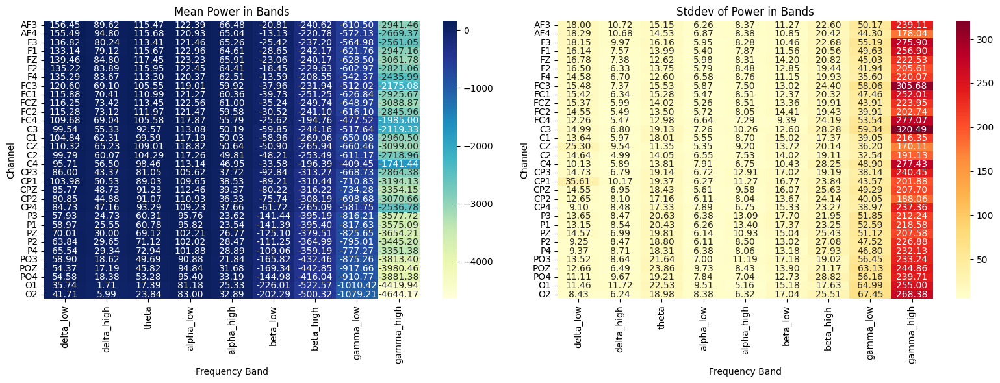

In [24]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_power_band_heatmaps(feature_powers, frequency_bands):
    channels = list(feature_powers.keys())
    bands = list(frequency_bands.keys())
    n_channels = len(channels)
    n_bands = len(bands)

    # Prepare matrices
    means = np.zeros((n_channels, n_bands))
    stds = np.zeros((n_channels, n_bands))

    for i, channel in enumerate(channels):
        for j, band in enumerate(bands):
            mean, std = feature_powers[channel][band]
            means[i, j] = mean
            stds[i, j] = std

    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    # Mean heatmap
    sns.heatmap(means, annot=True, fmt=".2f", cmap="YlGnBu", 
                xticklabels=bands, yticklabels=channels, ax=axes[0])
    axes[0].set_title("Mean Power in Bands")
    axes[0].set_xlabel("Frequency Band")
    axes[0].set_ylabel("Channel")

    # Stddev heatmap
    sns.heatmap(stds, annot=True, fmt=".2f", cmap="YlOrRd", 
                xticklabels=bands, yticklabels=channels, ax=axes[1])
    axes[1].set_title("Stddev of Power in Bands")
    axes[1].set_xlabel("Frequency Band")
    axes[1].set_ylabel("Channel")

    plt.tight_layout()
    plt.show()

# Usage:
plot_power_band_heatmaps(meditation_powers_pre, frequency_bands)

In [25]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_per_band_heatmaps(feature_powers, frequency_bands, value_type='mean', manual_color_scales=None):
    """
    Plots one heatmap per frequency band, each with its own color scale and colorbar.
    Returns a dictionary mapping each band to its (vmin, vmax) color scale.
    value_type: 'mean' or 'stddev'
    manual_color_scales: optional dict {band: (vmin, vmax), ...}
    """
    channels = list(feature_powers.keys())
    bands = list(frequency_bands.keys())
    n_channels = len(channels)
    n_bands = len(bands)

    # Prepare data: for each band, collect values for all channels
    data = np.zeros((n_bands, n_channels))
    for i, band in enumerate(bands):
        for j, channel in enumerate(channels):
            mean, std = feature_powers[channel][band]
            value = mean if value_type == 'mean' else std
            if np.isinf(value):
                value = np.nan
            data[i, j] = value

    colormaps = ["YlGnBu", "YlOrRd", "BuPu", "Greens", "Oranges", "Purples", "Blues"]
    fig, axes = plt.subplots(1, n_bands, figsize=(4*n_bands, 6), sharey=True)
    if n_bands == 1:
        axes = [axes]

    # Store color scales
    color_scales = {}

    for i, band in enumerate(bands):
        band_data = data[i, :].reshape(-1, 1)
        # Use manual color scale if provided, else compute from data
        if manual_color_scales and band in manual_color_scales and manual_color_scales[band] is not None:
            vmin, vmax = manual_color_scales[band]
        else:
            vmin = float(np.nanmin(band_data))
            vmax = float(np.nanmax(band_data))
            if np.isnan(vmin) or np.isnan(vmax):
                axes[i].set_visible(False)
                color_scales[band] = (np.nan, np.nan)
                continue
            if vmin == vmax:
                vmin -= 0.01
                vmax += 0.01
        color_scales[band] = (vmin, vmax)
        cmap = colormaps[i % len(colormaps)]
        sns.heatmap(
            band_data,
            annot=True,
            fmt=".2f",
            cmap=cmap,
            vmin=vmin,
            vmax=vmax,
            yticklabels=channels,
            xticklabels=[band],
            ax=axes[i],
            cbar=True,
            cbar_kws={"shrink": 0.7, "label": value_type}
        )
        axes[i].set_title(f"{band.capitalize()} ({value_type})")
        axes[i].set_xlabel("Band")
        if i == 0:
            axes[i].set_ylabel("Channel")
        else:
            axes[i].set_ylabel("")

    plt.tight_layout()
    plt.show()
    return color_scales


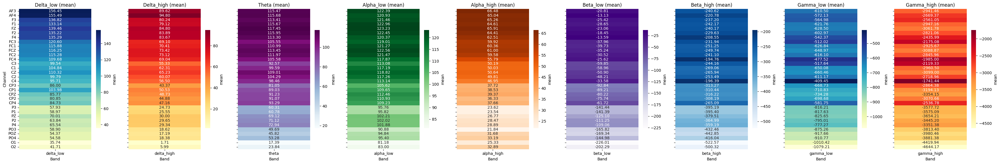

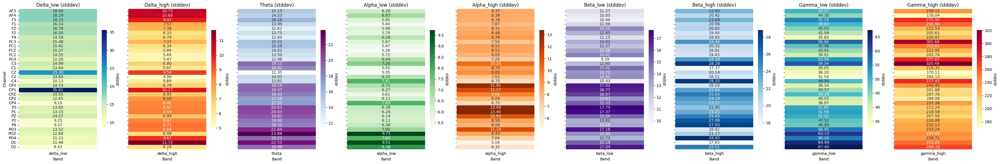

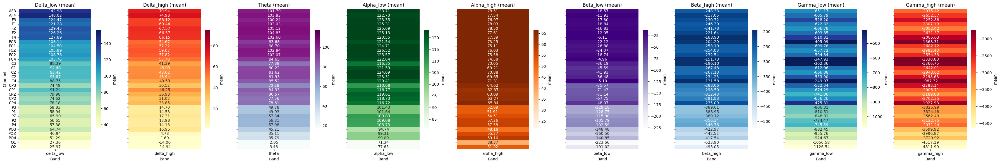

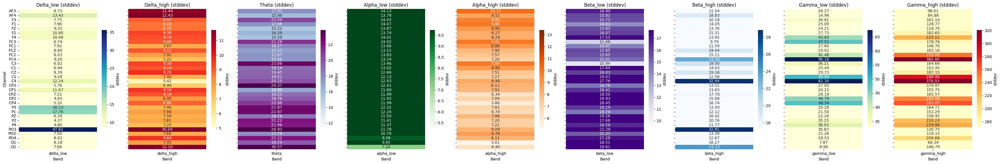

{'delta_low': (8.433343910644176, 35.60995066461389),
 'delta_high': (4.991076994145351, 11.72295431005504),
 'theta': (11.351263849128468, 23.8615163986227),
 'alpha_low': (5.25527061889915, 9.730944116445693),
 'alpha_high': (5.161616955602933, 13.396503915876151),
 'beta_low': (9.386087718735423, 17.698511378280312),
 'beta_high': (17.37371207608978, 28.81920929091519),
 'gamma_low': (32.54040170701907, 67.44685459534858),
 'gamma_high': (170.11394693642976, 320.4878319878534)}

In [26]:
# Usage:
mean_ranges = plot_per_band_heatmaps(meditation_powers_pre, frequency_bands, value_type='mean')
std_ranges = plot_per_band_heatmaps(meditation_powers_pre, frequency_bands, value_type='stddev')

plot_per_band_heatmaps(meditation_powers_post, frequency_bands, value_type='mean', manual_color_scales=mean_ranges)
plot_per_band_heatmaps(meditation_powers_post, frequency_bands, value_type='stddev', manual_color_scales=std_ranges)

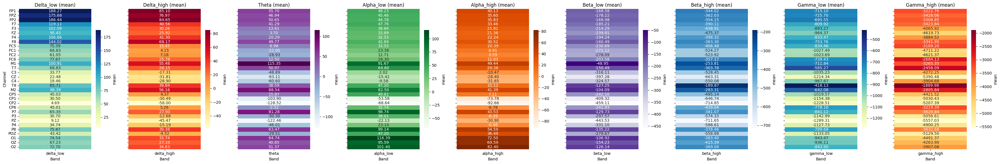

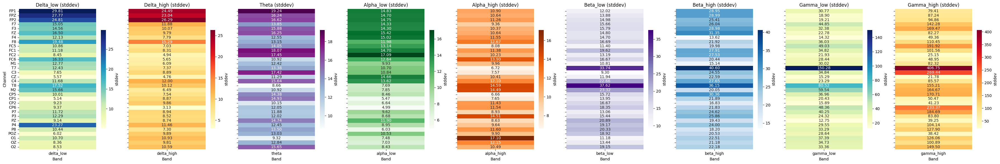

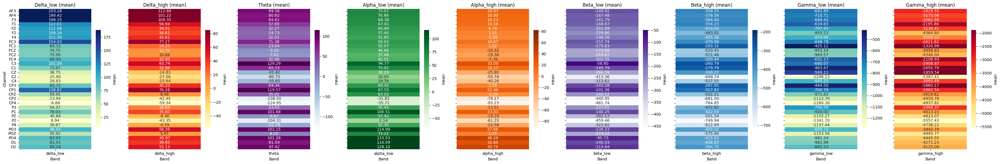

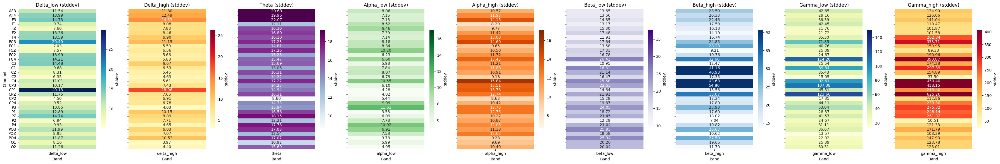

{'delta_low': (5.142080542965798, 29.81286354674991),
 'delta_high': (3.128907503032022, 26.292317601743576),
 'theta': (8.657063305714953, 19.23882638008903),
 'alpha_low': (4.985608988716308, 17.09036530812314),
 'alpha_high': (6.663462905344097, 17.10121159780499),
 'beta_low': (9.301822449143431, 37.618176958480845),
 'beta_high': (13.62364029437546, 40.59567878482484),
 'gamma_low': (12.745078396749864, 150.27832606179916),
 'gamma_high': (21.77590037639584, 406.74872532562046)}

In [27]:
mean_ranges = plot_per_band_heatmaps(tacs_powers_pre, frequency_bands, value_type='mean')
std_ranges = plot_per_band_heatmaps(tacs_powers_pre, frequency_bands, value_type='stddev')

plot_per_band_heatmaps(tacs_powers_post, frequency_bands, value_type='mean', manual_color_scales=mean_ranges)
plot_per_band_heatmaps(tacs_powers_post, frequency_bands, value_type='stddev', manual_color_scales=std_ranges)

feature_powers_1.keys():  dict_keys(['AF3', 'AF4', 'F3', 'F1', 'FZ', 'F2', 'F4', 'FC3', 'FC1', 'FCZ', 'FC2', 'FC4', 'C3', 'C1', 'CZ', 'C2', 'C4', 'CP3', 'CP1', 'CPZ', 'CP2', 'CP4', 'P3', 'P1', 'PZ', 'P2', 'P4', 'PO3', 'POZ', 'PO4', 'O1', 'O2'])
feature_powers_2.keys():  dict_keys(['AF3', 'AF4', 'F3', 'F1', 'FZ', 'F2', 'F4', 'FC3', 'FC1', 'FCZ', 'FC2', 'FC4', 'C3', 'C1', 'CZ', 'C2', 'C4', 'CP3', 'CP1', 'CPZ', 'CP2', 'CP4', 'P3', 'P1', 'PZ', 'P2', 'P4', 'PO3', 'POZ', 'PO4', 'O1', 'O2'])


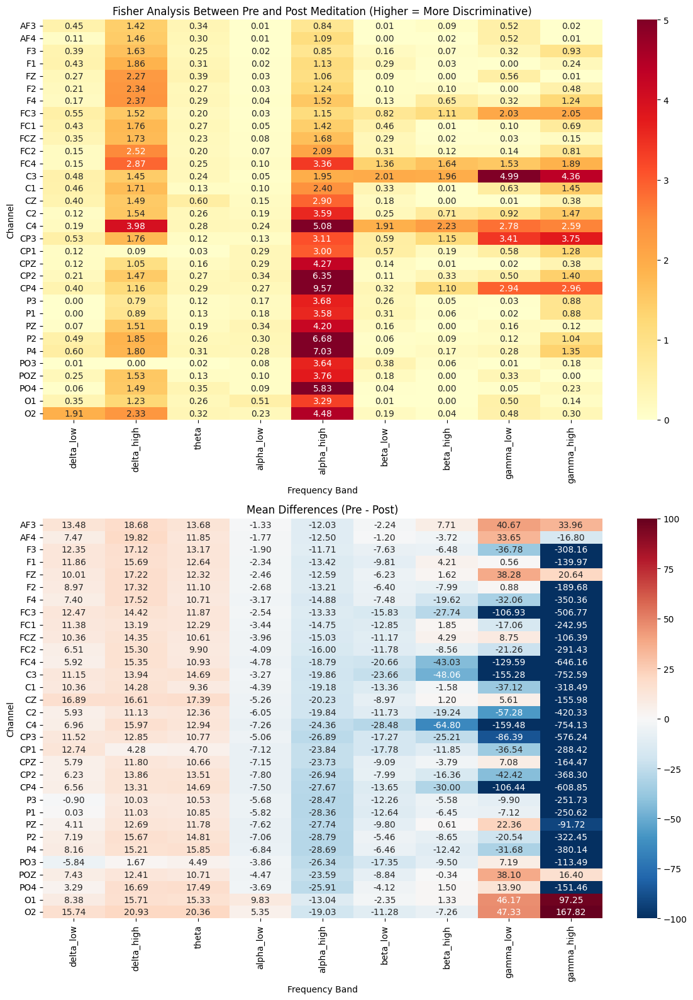

In [28]:
def compute_fisher_scores(feature_powers_1, feature_powers_2, frequency_bands):
    """
    Compute Fisher scores between two feature power objects.
    Fisher score = (μ1 - μ2)^2 / (σ1^2 + σ2^2)
    
    Args:
        feature_powers_1: First feature powers dict (e.g., pre-meditation)
        feature_powers_2: Second feature powers dict (e.g., post-meditation)
        frequency_bands: Dictionary of frequency bands
    
    Returns:
        fisher_scores: Dictionary of fisher scores per channel and band
        means_diff: Dictionary of mean differences
        fisher_heatmap_data: Processed data ready for heatmap plotting
    """
    channels = list(feature_powers_1.keys())
    bands = list(frequency_bands.keys())
    
    # Initialize results dictionaries
    fisher_scores = {}
    means_diff = {}
    
    # Initialize matrix for heatmap
    fisher_matrix = np.zeros((len(channels), len(bands)))

    print("feature_powers_1.keys(): ", feature_powers_1.keys()) 
    print("feature_powers_2.keys(): ", feature_powers_2.keys())
    
    # Compute Fisher scores for each channel and band
    for i, channel in enumerate(channels):
        fisher_scores[channel] = {}
        means_diff[channel] = {}
        
        for j, band in enumerate(bands):
            # Get means and standard deviations
            mean1, std1 = feature_powers_1[channel][band]
            mean2, std2 = feature_powers_2[channel][band]
            
            # Compute mean difference
            mean_diff = mean1 - mean2
            means_diff[channel][band] = mean_diff
            
            # Compute Fisher score
            # Handle potential division by zero or invalid values
            denominator = (std1**2 + std2**2)
            if denominator > 0 and not np.isnan(denominator) and not np.isinf(denominator):
                fisher_score = (mean_diff**2) / denominator
            else:
                fisher_score = np.nan
                
            fisher_scores[channel][band] = fisher_score
            fisher_matrix[i, j] = fisher_score
    
    return fisher_scores, means_diff, fisher_matrix

def plot_fisher_analysis(fisher_matrix, means_diff_matrix, channels, bands, manual_color_scales=None, title_name = None):
    """
    Plot Fisher scores and mean differences as heatmaps
    """
    fig, axes = plt.subplots(2, 1, figsize=(12, 16))
    
    # Fisher scores heatmap
    if manual_color_scales and 'fisher' in manual_color_scales:
        vmin, vmax = manual_color_scales['fisher']
    else:
        vmin, vmax = np.nanmin(fisher_matrix), np.nanmax(fisher_matrix)
    
    sns.heatmap(fisher_matrix, 
                annot=True, 
                fmt=".2f", 
                cmap="YlOrRd",
                xticklabels=bands,
                yticklabels=channels,
                vmin=vmin,
                vmax=vmax,
                ax=axes[0])
    if title_name:
        axes[0].set_title(title_name)
    else:
        axes[0].set_title("Fisher Scores (Higher = More Discriminative)")
    axes[0].set_xlabel("Frequency Band")
    axes[0].set_ylabel("Channel")
    
    # Mean differences heatmap
    if manual_color_scales and 'means_diff' in manual_color_scales:
        vmin, vmax = manual_color_scales['means_diff']
    else:
        vmin, vmax = np.nanmin(means_diff_matrix), np.nanmax(means_diff_matrix)
    
    sns.heatmap(means_diff_matrix,
                annot=True,
                fmt=".2f",
                cmap="RdBu_r",  # Red-Blue diverging colormap
                center=0,       # Center the colormap at 0
                xticklabels=bands,
                yticklabels=channels,
                vmin=vmin,
                vmax=vmax,
                ax=axes[1])
    axes[1].set_title("Mean Differences (Pre - Post)")
    axes[1].set_xlabel("Frequency Band")
    axes[1].set_ylabel("Channel")
    
    plt.tight_layout()
    plt.show()

# Example usage:
def analyze_power_differences(feature_powers_1, feature_powers_2, frequency_bands, manual_color_scales=None, title_name = None):
    """
    Complete workflow to analyze differences between two feature power objects
    """
    if feature_powers_1 is None or feature_powers_2 is None:
        return None, None
    # Compute Fisher scores and mean differences
    fisher_scores, means_diff, fisher_matrix = compute_fisher_scores(
        feature_powers_1, 
        feature_powers_2, 
        frequency_bands
    )
    
    # Prepare means_diff matrix for plotting
    channels = list(feature_powers_1.keys())
    bands = list(frequency_bands.keys())
    means_diff_matrix = np.zeros((len(channels), len(bands)))
    for i, channel in enumerate(channels):
        for j, band in enumerate(bands):
            means_diff_matrix[i, j] = means_diff[channel][band]
    
    # Plot the results
    plot_fisher_analysis(
        fisher_matrix, 
        means_diff_matrix, 
        channels, 
        bands, 
        manual_color_scales,
        title_name
    )
    
    return fisher_scores, means_diff

# Usage example:
fisher_scores_meditation, means_diff_meditation = analyze_power_differences(
    meditation_powers_pre,
    meditation_powers_post,
    frequency_bands,
    manual_color_scales={'fisher': (0, 5), 'means_diff': (-100, 100)},
    title_name = 'Fisher Analysis Between Pre and Post Meditation (Higher = More Discriminative)'
)

In [ ]:
# hotswap keys of tacs_powers_post with the keys of tacs_powers_pre even though they are not the same
ordering_of_pre = list(tacs_powers_pre.keys())
ordering_of_post = list(tacs_powers_post.keys())
lookup_table = {post_channel: pre_channel for pre_channel, post_channel in zip(ordering_of_pre, ordering_of_post)}

tacs_powers_post = {lookup_table[post_key]: tacs_powers_post[post_key] for post_key in ordering_of_post}


In [30]:
print(tacs_powers_post)

{'FP1': {'delta_low': (np.float64(203.26265556693997), np.float64(11.543581164960042)), 'delta_high': (np.float64(112.86026393602552), np.float64(11.795155745853002)), 'theta': (np.float64(89.55765670666426), np.float64(20.633239275841028)), 'alpha_low': (np.float64(73.06933340523474), np.float64(8.05619978481173)), 'alpha_high': (np.float64(20.069298312726062), np.float64(10.567994478399752)), 'beta_low': (np.float64(-149.92297359926553), np.float64(13.652571014011464)), 'beta_high': (np.float64(-358.547337665172), np.float64(23.497783582418602)), 'gamma_low': (np.float64(-682.8931441794329), np.float64(42.65387809548385)), 'gamma_high': (np.float64(-2929.5494656047226), np.float64(134.90148131340084))}, 'FPZ': {'delta_low': (np.float64(190.4199052692914), np.float64(13.988653317154045)), 'delta_high': (np.float64(101.21546896156684), np.float64(12.494008376970637)), 'theta': (np.float64(80.61719438409116), np.float64(19.96209305567574)), 'alpha_low': (np.float64(70.86236093693324), n

feature_powers_1.keys():  dict_keys(['FP1', 'FPZ', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'FC5', 'FC1', 'FC2', 'FC6', 'M1', 'T7', 'C3', 'CZ', 'C4', 'T8', 'M2', 'CP5', 'CP1', 'CP2', 'CP6', 'P7', 'P3', 'PZ', 'P4', 'P8', 'POZ', 'O1', 'OZ', 'O2'])
feature_powers_2.keys():  dict_keys(['FP1', 'FPZ', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'FC5', 'FC1', 'FC2', 'FC6', 'M1', 'T7', 'C3', 'CZ', 'C4', 'T8', 'M2', 'CP5', 'CP1', 'CP2', 'CP6', 'P7', 'P3', 'PZ', 'P4', 'P8', 'POZ', 'O1', 'OZ', 'O2'])


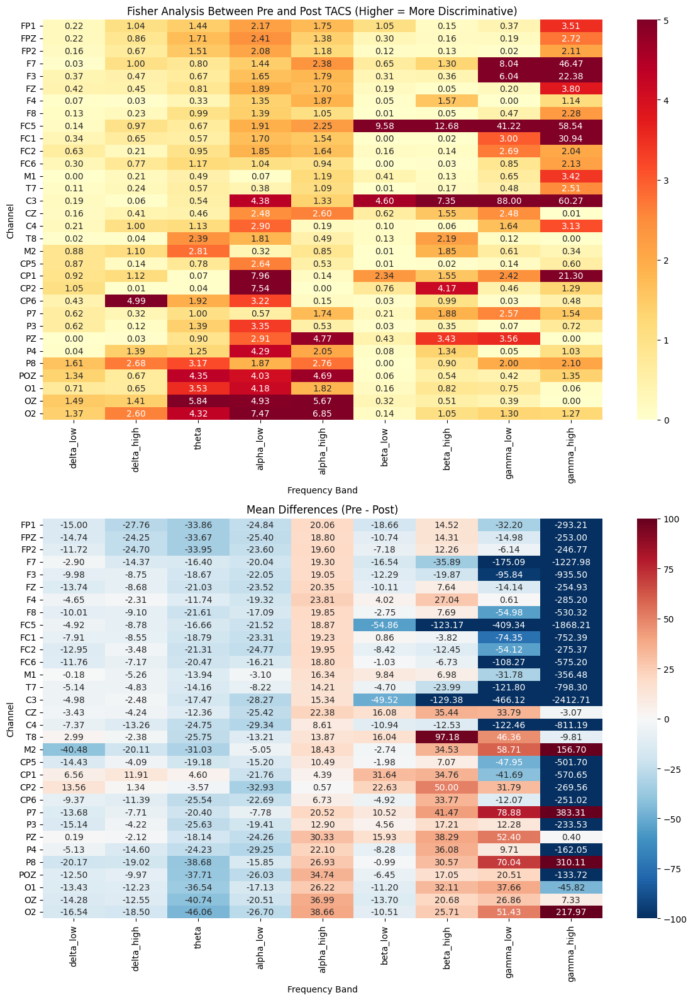

In [ ]:


fisher_scores_tacs, means_diff_tacs = analyze_power_differences(
    tacs_powers_pre,
    tacs_powers_post,
    frequency_bands,
    manual_color_scales={'fisher': (0, 5), 'means_diff': (-100, 100)},
    title_name = 'Fisher Analysis Between Pre and Post TACS (Higher = More Discriminative)'
)

feature_powers_1.keys():  dict_keys(['FP1', 'FPZ', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'FC5', 'FC1', 'FC2', 'FC6', 'M1', 'T7', 'C3', 'CZ', 'C4', 'T8', 'M2', 'CP5', 'CP1', 'CP2', 'CP6', 'P7', 'P3', 'PZ', 'P4', 'P8', 'POZ', 'O1', 'OZ', 'O2'])
feature_powers_2.keys():  dict_keys(['FP1', 'FPZ', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'FC5', 'FC1', 'FC2', 'FC6', 'M1', 'T7', 'C3', 'CZ', 'C4', 'T8', 'M2', 'CP5', 'CP1', 'CP2', 'CP6', 'P7', 'P3', 'PZ', 'P4', 'P8', 'POZ', 'O1', 'OZ', 'O2'])


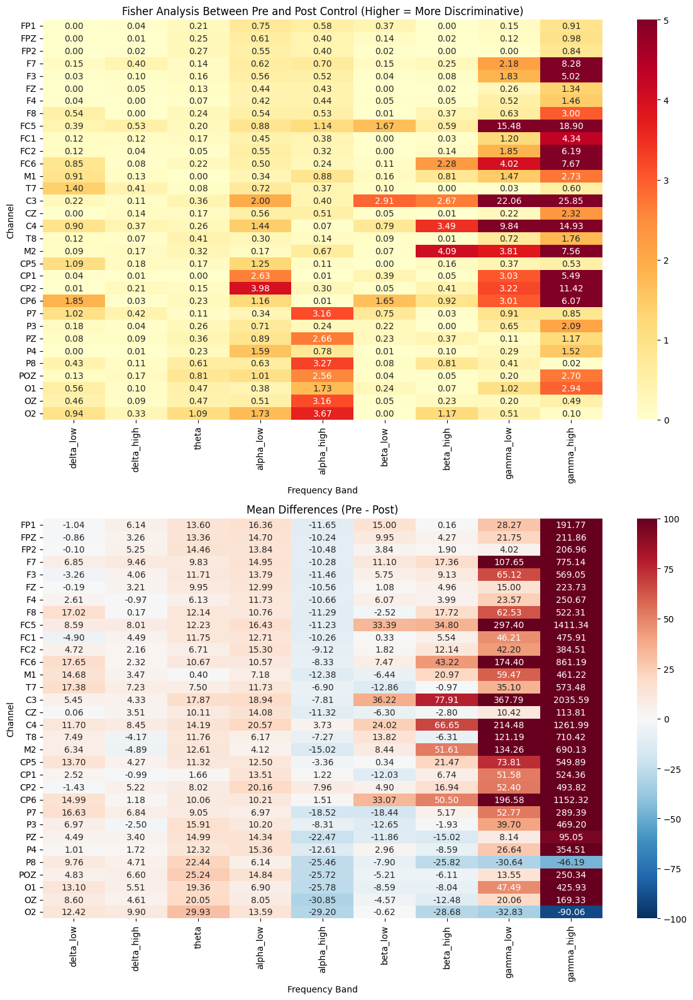

In [32]:
fisher_scores_control, means_diff_control = analyze_power_differences(
    control_powers_pre,
    control_powers_post,
    frequency_bands,
    manual_color_scales={'fisher': (0, 5), 'means_diff': (-100, 100)},
    title_name = 'Fisher Analysis Between Pre and Post Control (Higher = More Discriminative)'
)

In [33]:
!pip install scipy
!pip install mne

from topoplot import make_topoplot

In [34]:
print(fisher_scores_meditation)

{'AF3': {'delta_low': np.float64(0.45382792807245975), 'delta_high': np.float64(1.4202658770698873), 'theta': np.float64(0.3397493689034179), 'alpha_low': np.float64(0.007368081309879814), 'alpha_high': np.float64(0.8358722328431201), 'beta_low': np.float64(0.012195267223815242), 'beta_high': np.float64(0.09238342478378798), 'gamma_low': np.float64(0.5157040276230027), 'gamma_high': np.float64(0.01726483594076754)}, 'AF4': {'delta_low': np.float64(0.10844233880615882), 'delta_high': np.float64(1.4627739197131173), 'theta': np.float64(0.3013774608494016), 'alpha_low': np.float64(0.013152422171796636), 'alpha_high': np.float64(1.0939002596465106), 'beta_low': np.float64(0.003923257864699165), 'beta_high': np.float64(0.017966822027223498), 'gamma_low': np.float64(0.5181558520655375), 'gamma_high': np.float64(0.007255014467279021)}, 'F3': {'delta_low': np.float64(0.391797441716807), 'delta_high': np.float64(1.6292169359107753), 'theta': np.float64(0.25400055280696077), 'alpha_low': np.floa

In [35]:
def dict_transpose(d):
    if d is None:
        return None
    channels = list(d.keys())
    bands = list(d[channels[0]].keys())
    transposed = {band: {channel: d[channel][band] for channel in channels} for band in bands}
    return transposed




In [36]:
transposed_fisher_scores_meditation = dict_transpose(fisher_scores_meditation)
transposed_fisher_scores_tacs = dict_transpose(fisher_scores_tacs)
transposed_fisher_scores_control = dict_transpose(fisher_scores_control)

print(transposed_fisher_scores_meditation)
print(transposed_fisher_scores_tacs)
print(transposed_fisher_scores_control)



{'delta_low': {'AF3': np.float64(0.45382792807245975), 'AF4': np.float64(0.10844233880615882), 'F3': np.float64(0.391797441716807), 'F1': np.float64(0.43453468907573467), 'FZ': np.float64(0.27209496860714266), 'F2': np.float64(0.20683932888835654), 'F4': np.float64(0.16989109006410702), 'FC3': np.float64(0.5451321455139287), 'FC1': np.float64(0.43111485985702885), 'FCZ': np.float64(0.3461256503940254), 'FC2': np.float64(0.15329692537299722), 'FC4': np.float64(0.14895441675589557), 'C3': np.float64(0.476396334345298), 'C1': np.float64(0.4580070872547519), 'CZ': np.float64(0.401663259070367), 'C2': np.float64(0.11697786628635251), 'C4': np.float64(0.19184425222719043), 'CP3': np.float64(0.5293841767919341), 'CP1': np.float64(0.11563659093190158), 'CPZ': np.float64(0.12498160360322587), 'CP2': np.float64(0.2105425304455392), 'CP4': np.float64(0.39565212916852516), 'P3': np.float64(0.0015825885625647843), 'P1': np.float64(2.257060942318528e-06), 'PZ': np.float64(0.0667430648308531), 'P2': 

In [37]:
tacs_location = "ch32Locations.mat"
meditation_location = "ErrP_cap_chan_file.mat"
control_location = "ch32Locations.mat"



['AF3', 'AF4', 'F3', 'F1', 'FZ', 'F2', 'F4', 'FC3', 'FC1', 'FCZ', 'FC2', 'FC4', 'C3', 'C1', 'CZ', 'C2', 'C4', 'CP3', 'CP1', 'CPZ', 'CP2', 'CP4', 'P3', 'P1', 'PZ', 'P2', 'P4', 'PO3', 'POZ', 'PO4', 'O1', 'O2']
['AF3', 'AF4', 'F3', 'F1', 'FZ', 'F2', 'F4', 'FC3', 'FC1', 'FCZ', 'FC2', 'FC4', 'C3', 'C1', 'CZ', 'C2', 'C4', 'CP3', 'CP1', 'CPZ', 'CP2', 'CP4', 'P3', 'P1', 'PZ', 'P2', 'P4', 'PO3', 'POZ', 'PO4', 'O1', 'O2']
{'AF3': array([0.03693152, 0.07919991, 0.02756374]), 'AF4': array([-0.03693152,  0.07919991,  0.02756374]), 'F3': array([0.04954613, 0.06118438, 0.05      ]), 'F1': array([0.02608775, 0.06456946, 0.06427876]), 'Fz': array([0.        , 0.06539453, 0.06946584]), 'F2': array([-0.02608775,  0.06456946,  0.06427876]), 'F4': array([-0.04954613,  0.06118438,  0.05      ]), 'FC3': array([0.06148883, 0.03269419, 0.06427876]), 'FC1': array([0.0340645 , 0.0340645 , 0.08480481]), 'FCz': array([0.        , 0.03552101, 0.09205049]), 'FC2': array([-0.0340645 ,  0.0340645 ,  0.08480481]), 'FC4

(<Figure size 1800x1800 with 18 Axes>,
 array([<Axes: title={'center': 'delta_low'}>,
        <Axes: title={'center': 'delta_high'}>,
        <Axes: title={'center': 'theta'}>,
        <Axes: title={'center': 'alpha_low'}>,
        <Axes: title={'center': 'alpha_high'}>,
        <Axes: title={'center': 'beta_low'}>,
        <Axes: title={'center': 'beta_high'}>,
        <Axes: title={'center': 'gamma_low'}>,
        <Axes: title={'center': 'gamma_high'}>], dtype=object))

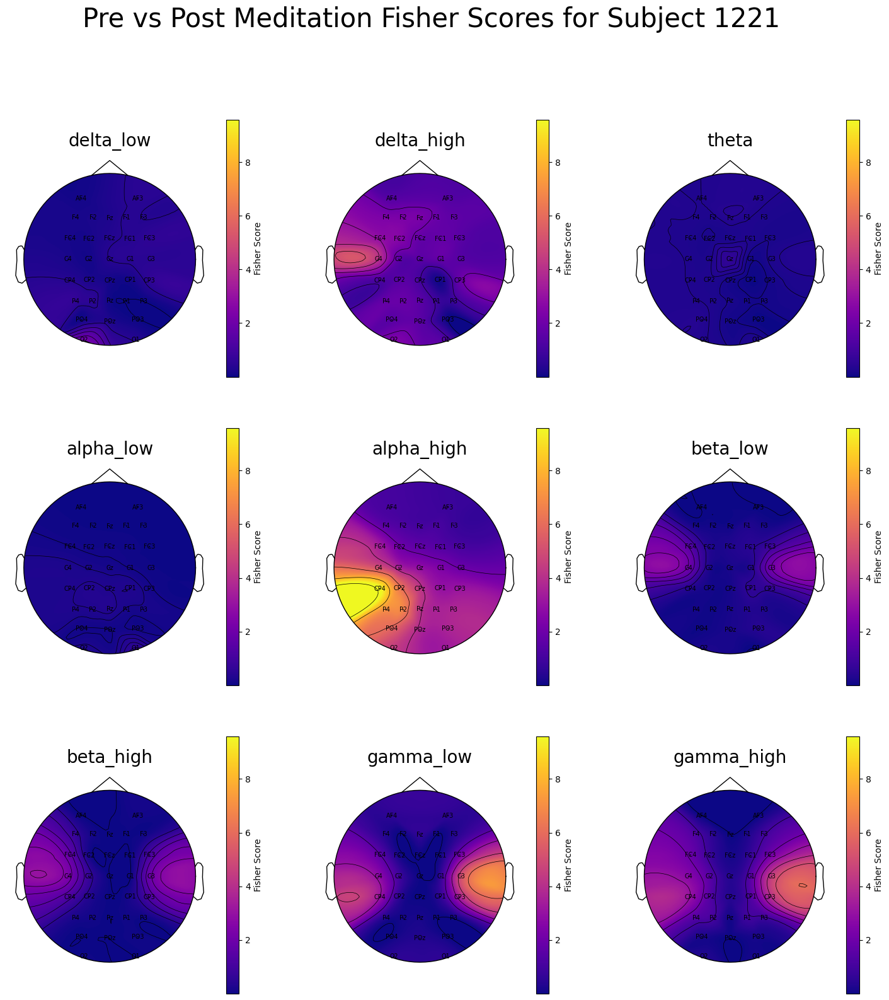

In [38]:
#meditation:
meditation_fisher_scores_names = list(frequency_bands.keys())
meditation_fisher_scores = [list(transposed_fisher_scores_meditation[k].values()) for k in meditation_fisher_scores_names]
make_topoplot(meditation_location, run_fisher_scores=meditation_fisher_scores, channel_ordering=transposed_fisher_scores_meditation['alpha_high'].keys(), fisher_scores_names=meditation_fisher_scores_names, figure_title = f'Pre vs Post Meditation Fisher Scores for Subject {subject}')

['FP1', 'FPZ', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'FC5', 'FC1', 'FC2', 'FC6', 'M1', 'T7', 'C3', 'CZ', 'C4', 'T8', 'M2', 'CP5', 'CP1', 'CP2', 'CP6', 'P7', 'P3', 'PZ', 'P4', 'P8', 'POZ', 'O1', 'OZ', 'O2']
['FP1', 'FPZ', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'FC5', 'FC1', 'FC2', 'FC6', 'M1', 'T7', 'C3', 'CZ', 'C4', 'T8', 'M2', 'CP5', 'CP1', 'CP2', 'CP6', 'P7', 'P3', 'PZ', 'P4', 'P8', 'POZ', 'O1', 'OZ', 'O2']
{'Fp1': array([ 0.02613301,  0.08078401, -0.00400108]), 'Fpz': array([ 0.        ,  0.08498123, -0.00178604]), 'Fp2': array([-0.02613301,  0.08078401, -0.00400108]), 'F7': array([ 0.06842334,  0.04987138, -0.00748952]), 'F3': array([0.04820043, 0.05755106, 0.03986971]), 'Fz': array([0.        , 0.06073848, 0.0594629 ]), 'F4': array([-0.0481426 ,  0.05758403,  0.03989198]), 'F8': array([-0.06838359,  0.04992653, -0.00748509]), 'FC5': array([0.07624736, 0.02876282, 0.02416691]), 'FC1': array([0.03235138, 0.03243618, 0.07159806]), 'FC2': array([-0.03235138,  0.03243618,  0.07159806]), '

(<Figure size 1800x1800 with 18 Axes>,
 array([<Axes: title={'center': 'delta_low'}>,
        <Axes: title={'center': 'delta_high'}>,
        <Axes: title={'center': 'theta'}>,
        <Axes: title={'center': 'alpha_low'}>,
        <Axes: title={'center': 'alpha_high'}>,
        <Axes: title={'center': 'beta_low'}>,
        <Axes: title={'center': 'beta_high'}>,
        <Axes: title={'center': 'gamma_low'}>,
        <Axes: title={'center': 'gamma_high'}>], dtype=object))

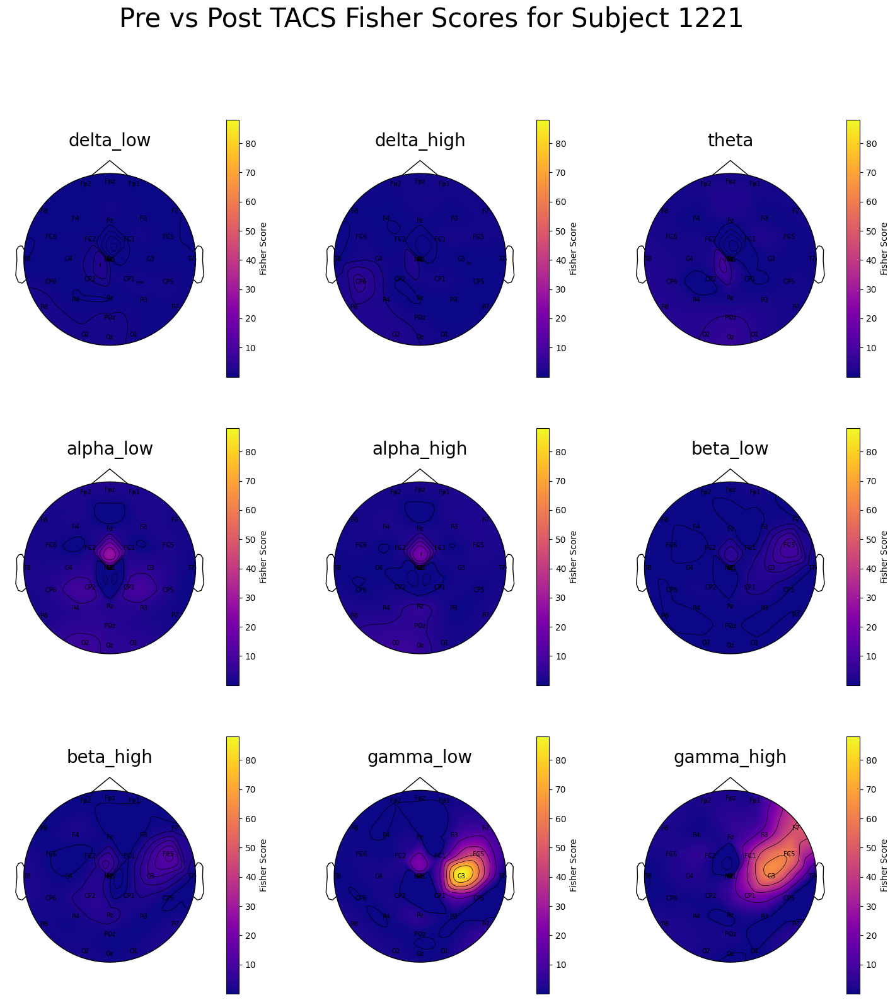

In [39]:
#tacs
tacs_fisher_scores_names = list(frequency_bands.keys())
tacs_fisher_scores = [list(transposed_fisher_scores_tacs[k].values()) for k in tacs_fisher_scores_names]
make_topoplot(tacs_location, run_fisher_scores=tacs_fisher_scores, channel_ordering=transposed_fisher_scores_tacs['alpha_high'].keys(), fisher_scores_names=tacs_fisher_scores_names, figure_title = f'Pre vs Post TACS Fisher Scores for Subject {subject}')


['FP1', 'FPZ', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'FC5', 'FC1', 'FC2', 'FC6', 'M1', 'T7', 'C3', 'CZ', 'C4', 'T8', 'M2', 'CP5', 'CP1', 'CP2', 'CP6', 'P7', 'P3', 'PZ', 'P4', 'P8', 'POZ', 'O1', 'OZ', 'O2']
['FP1', 'FPZ', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'FC5', 'FC1', 'FC2', 'FC6', 'M1', 'T7', 'C3', 'CZ', 'C4', 'T8', 'M2', 'CP5', 'CP1', 'CP2', 'CP6', 'P7', 'P3', 'PZ', 'P4', 'P8', 'POZ', 'O1', 'OZ', 'O2']
{'Fp1': array([ 0.02613301,  0.08078401, -0.00400108]), 'Fpz': array([ 0.        ,  0.08498123, -0.00178604]), 'Fp2': array([-0.02613301,  0.08078401, -0.00400108]), 'F7': array([ 0.06842334,  0.04987138, -0.00748952]), 'F3': array([0.04820043, 0.05755106, 0.03986971]), 'Fz': array([0.        , 0.06073848, 0.0594629 ]), 'F4': array([-0.0481426 ,  0.05758403,  0.03989198]), 'F8': array([-0.06838359,  0.04992653, -0.00748509]), 'FC5': array([0.07624736, 0.02876282, 0.02416691]), 'FC1': array([0.03235138, 0.03243618, 0.07159806]), 'FC2': array([-0.03235138,  0.03243618,  0.07159806]), '

(<Figure size 1800x1800 with 18 Axes>,
 array([<Axes: title={'center': 'delta_low'}>,
        <Axes: title={'center': 'delta_high'}>,
        <Axes: title={'center': 'theta'}>,
        <Axes: title={'center': 'alpha_low'}>,
        <Axes: title={'center': 'alpha_high'}>,
        <Axes: title={'center': 'beta_low'}>,
        <Axes: title={'center': 'beta_high'}>,
        <Axes: title={'center': 'gamma_low'}>,
        <Axes: title={'center': 'gamma_high'}>], dtype=object))

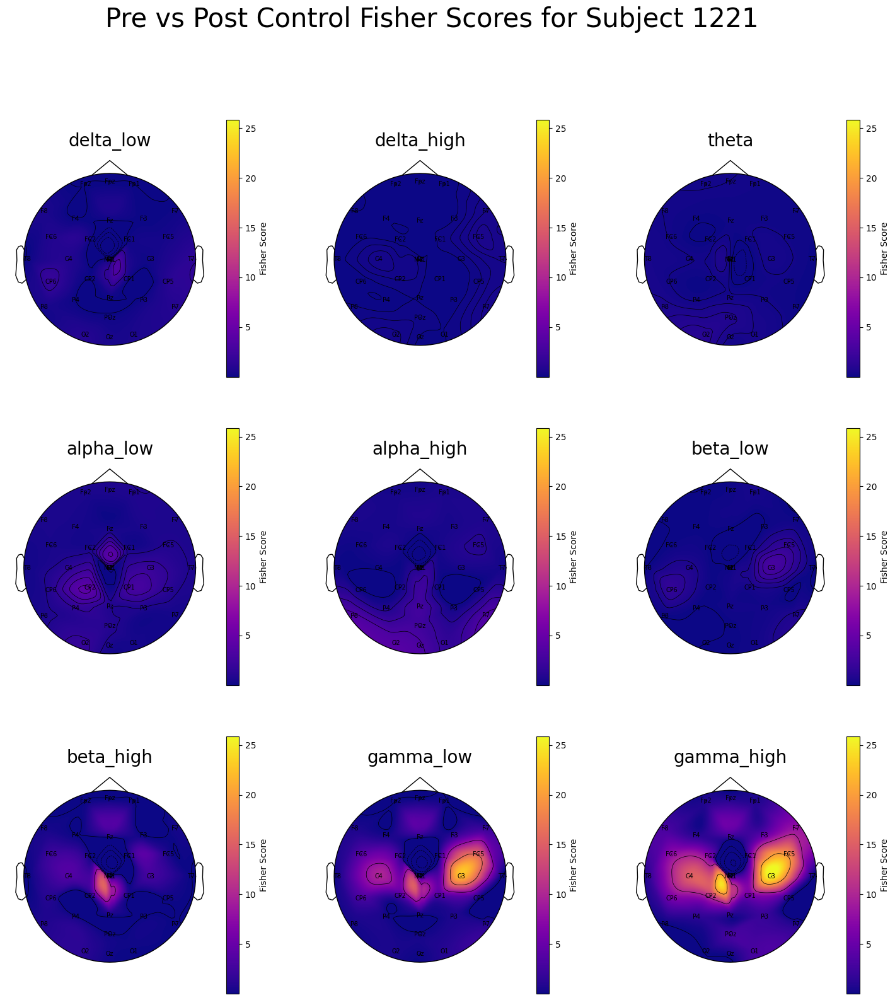

In [40]:
# control
control_fisher_scores_names = list(frequency_bands.keys())
control_fisher_scores = [list(transposed_fisher_scores_control[k].values()) for k in control_fisher_scores_names]
make_topoplot(control_location, run_fisher_scores=control_fisher_scores, channel_ordering=transposed_fisher_scores_control['alpha_high'].keys(), fisher_scores_names=control_fisher_scores_names, figure_title = f'Pre vs Post Control Fisher Scores for Subject {subject}')